# Example Notebook (Adult Census Income Dataset)

In [1]:
import os
import xai
import logging as log 
import warnings
import matplotlib.pyplot as plt
import sys, os
from util.commons import *
from util.ui import *
from util.model import *
from util.split import *
from util.dataset import *
from IPython.display import display, HTML

## Load a dataset
For this example we are going to use 'Adult Census Dataset'. It consists of both categorical and numerical features.

In [2]:
dataset, msg = get_dataset('census')
display(msg)
display(dataset.df)

"Dataset 'census (Adult census dataset)' loaded successfully. For further information about this dataset please visit: https://ethicalml.github.io/xai/index.html?highlight=load_census#xai.data.load_census"

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,<=50K
32557,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,>50K
32558,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,<=50K
32559,22,Private,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,<=50K


## Preprocess the dataset
There are values in the dataset that are unknown (*\?*). In this step all rows containing such values are going to be removed. 

In [3]:
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' ?', ' Self-emp-inc', ' Without-pay',
       ' Never-worked'], dtype=object)

In [4]:
dataset.df.loc[dataset.df['workclass'] == ' ?']

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
27,54,?,Some-college,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,>50K
61,32,?,7th-8th,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,<=50K
69,25,?,Some-college,10,Never-married,?,Own-child,White,Male,0,0,40,<=50K
77,67,?,10th,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,<=50K
106,17,?,10th,6,Never-married,?,Own-child,White,Female,34095,0,32,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32530,35,?,Bachelors,13,Married-civ-spouse,?,Wife,White,Female,0,0,55,>50K
32531,30,?,Bachelors,13,Never-married,?,Not-in-family,Asian-Pac-Islander,Female,0,0,99,<=50K
32539,71,?,Doctorate,16,Married-civ-spouse,?,Husband,White,Male,0,0,10,>50K
32541,41,?,HS-grad,9,Separated,?,Not-in-family,Black,Female,0,0,32,<=50K


In [5]:
dataset.df = remove_undefined_rows(' ?', dataset.df)
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' Self-emp-inc', ' Without-pay'], dtype=object)

## Visualize the dataset
Three visualization functions offered by the [XAI](https://github.com/EthicalML/XAI) module will be used for analyzing the dataset.
* The first one shows the imbalances of selected features. In the first plot below, for example, we can see that the majority of samples (people) are *white* *male* (gender='Male', ethnicity='White').
* The second and third plots show correlations between the features. The second one plots the correlations as a matrix, whereas the third one as a hierarchical dendogram.

15-Mar-21 23:45:52 - No categorical_cols passed so inferred using np.object, np.int8 and np.bool: Index(['workclass', 'education', 'marital-status', 'occupation',
       'relationship', 'ethnicity', 'gender', 'loan'],
      dtype='object'). If you see an error these are not correct, please provide them as a string array as: categorical_cols=['col1', 'col2', ...]


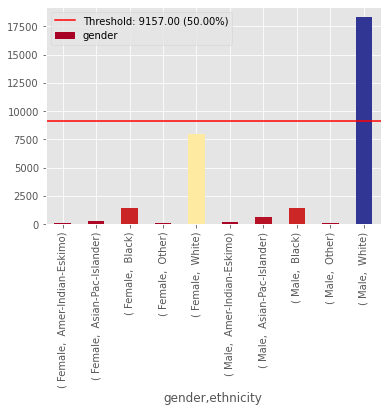

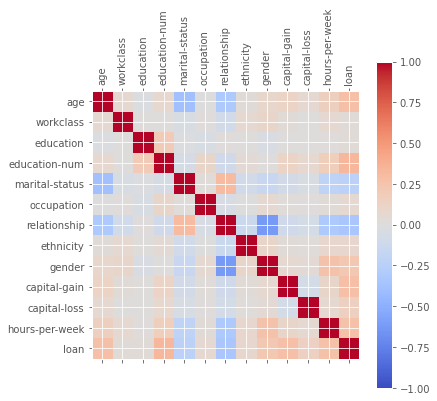

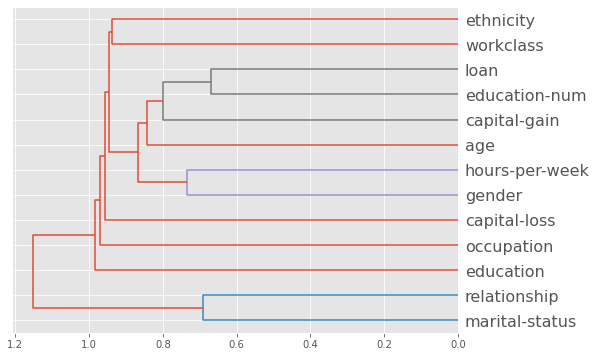

In [6]:
%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

imbalanced_cols = ['gender', 'ethnicity']

xai.imbalance_plot(dataset.df, *imbalanced_cols)
_ = xai.correlations(dataset.df, include_categorical=True, plot_type="matrix", plt_kwargs={'figsize': (6, 6)})
_ = xai.correlations(dataset.df, include_categorical=True, plt_kwargs={'figsize': (8, 6)})

## Target
In the cell below the target variable is selected. In this example we will use the column **loan** as target variable, which shows whether a person earns more than 50k (*>50K | <=50K*) per year.

In [7]:
df_X, df_y, msg = split_feature_target(dataset.df, "loan")
df_y

15-Mar-21 23:45:55 - Target 'loan' selected successfully.


0         <=50K
1         <=50K
2         <=50K
3         <=50K
4         <=50K
          ...  
30713     <=50K
30714      >50K
30715     <=50K
30716     <=50K
30717      >50K
Name: loan, Length: 30718, dtype: object

## Training the models
Four models are going to be trained on this dataset. In the output below we can see accuracy, classification reports, confusion matrix and ROC Curve for each model.
 * Model 1: Logistic Regression

15-Mar-21 23:45:57 - Model accuracy: 0.7943793402777778
15-Mar-21 23:45:58 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.93      0.79      0.85      6921
        >50K       0.56      0.81      0.66      2295

    accuracy                           0.79      9216
   macro avg       0.74      0.80      0.76      9216
weighted avg       0.83      0.79      0.80      9216



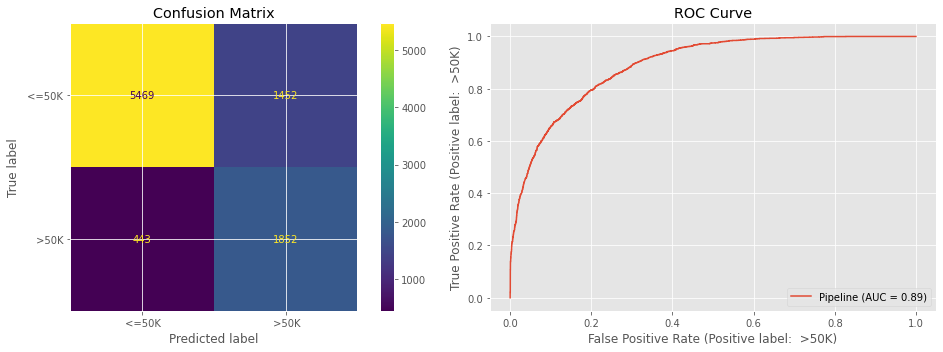

15-Mar-21 23:46:00 - Model Model 1 trained successfully!


In [8]:
# Create empty models
initial_models, msg = fill_empty_models(df_X, df_y, 4)
models = []

model1 = initial_models[0]
msg = fill_model(model1, Algorithm.LOGISTIC_REGRESSION, Split(SplitTypes.NORMAL))
models.append(model1)
model_1 = models[0]

 * Model 2: Decision Tree

15-Mar-21 23:46:03 - Model accuracy: 0.8100043402777778
15-Mar-21 23:46:04 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.89      0.85      0.87      6921
        >50K       0.61      0.68      0.64      2295

    accuracy                           0.81      9216
   macro avg       0.75      0.77      0.76      9216
weighted avg       0.82      0.81      0.81      9216



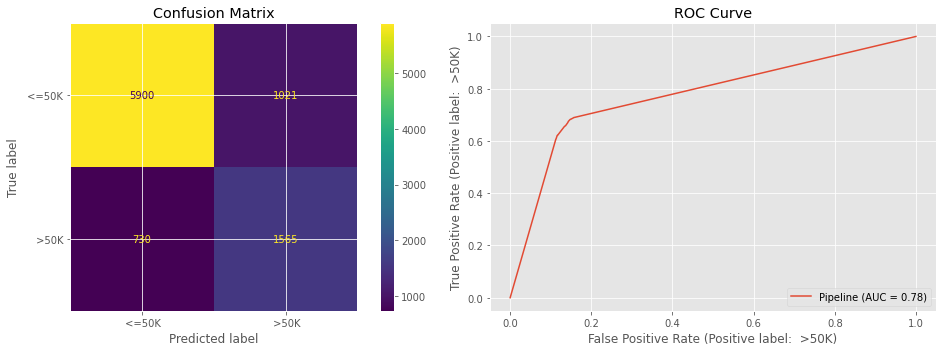

15-Mar-21 23:46:07 - Model Model 2 trained successfully!


In [9]:
model2 = initial_models[1]
msg = fill_model(model2, Algorithm.DECISION_TREE, Split(SplitTypes.NORMAL))
models.append(model2)
model_2 = models[1]

 * Model 3: Random Forest

15-Mar-21 23:46:32 - Model accuracy: 0.8428819444444444
15-Mar-21 23:46:33 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.89      0.91      0.90      6921
        >50K       0.70      0.65      0.67      2295

    accuracy                           0.84      9216
   macro avg       0.79      0.78      0.79      9216
weighted avg       0.84      0.84      0.84      9216



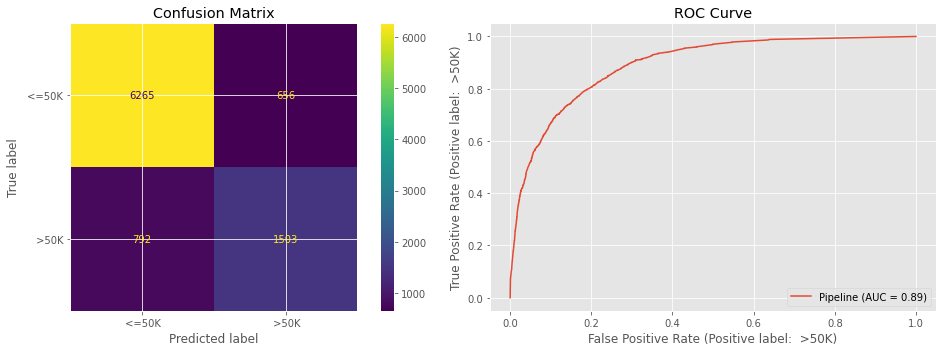

15-Mar-21 23:46:36 - Model Model 3 trained successfully!


In [10]:
model3 = initial_models[2]
msg = fill_model(model3, Algorithm.RANDOM_FOREST, Split(SplitTypes.NORMAL))
models.append(model3)
model_3 = models[2]

 * Model 4: Support Vector Machine

15-Mar-21 23:56:09 - Model accuracy: 0.7941623263888888
15-Mar-21 23:56:10 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.81      0.95      0.87      6921
        >50K       0.69      0.31      0.43      2295

    accuracy                           0.79      9216
   macro avg       0.75      0.63      0.65      9216
weighted avg       0.78      0.79      0.76      9216



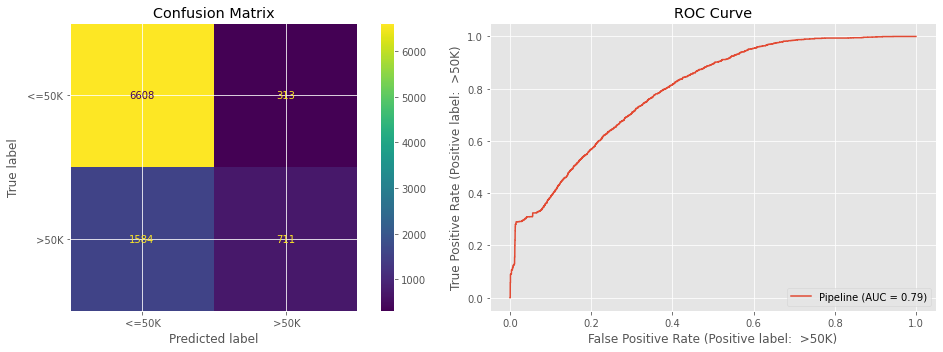

15-Mar-21 23:57:54 - Model Model 4 trained successfully!


In [11]:
model4 = initial_models[3]
msg = fill_model(model4, Algorithm.SVC, Split(SplitTypes.NORMAL))
models.append(model4)
model_4 = models[3]

## Global model interpretations
In the following steps we will use global interpretation techniques that help us to answer questions like how does a model behave in general? What features drive predictions and what features are completely useless. This data may be very important in understanding the model better. Most of the techniques work by investigating the conditional interactions between the target variable and the features on the complete dataset.

### Feature importance
The importance of a feature is the increase in the prediction error of the model after we permuted the feature’s values, which breaks the relationship between the feature and the true outcome. A feature is “important” if permuting it increases the model error. This is because in that case, the model relied heavily on this feature for making right prediction. On the other hand, a feature is “unimportant” if permuting it doesn’t affect the error by much or doesn’t change it at all.

#### ELI5
In the first case, we use [ELI5](https://github.com/TeamHG-Memex/eli5), which does not permute the features but only visualizes the weight of each feature.

 * Model 1 (Logistic Regression)

In [12]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_1)
display(plot)

15-Mar-21 23:57:54 - Generating a feature importance plot using ELI5 for Model 1 ...


 * Model 2 (Decision Tree)

In [13]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_2)
display(plot)

15-Mar-21 23:57:54 - Generating a feature importance plot using ELI5 for Model 2 ...


Weight,Feature
0.2975,marital-status_ Married-civ-spouse
0.1666,age
0.1025,education-num
0.0964,capital-gain
0.0820,hours-per-week
0.0281,capital-loss
0.0135,workclass_ Private
0.0118,occupation_ Sales
0.0111,occupation_ Prof-specialty
0.0106,occupation_ Craft-repair


 * Model 3 (Random Forest)

In [14]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_3)
display(plot)

15-Mar-21 23:57:57 - Generating a feature importance plot using ELI5 for Model 3 ...


Weight,Feature
0.2171 ± 0.0530,age
0.1083 ± 0.0306,hours-per-week
0.1025 ± 0.1945,marital-status_ Married-civ-spouse
0.0719 ± 0.0375,capital-gain
0.0646 ± 0.0651,education-num
0.0534 ± 0.1463,relationship_ Husband
0.0502 ± 0.1306,marital-status_ Never-married
0.0234 ± 0.0105,capital-loss
0.0160 ± 0.0179,occupation_ Prof-specialty
0.0149 ± 0.0377,relationship_ Not-in-family


 * Model 4 (Support Vector Machine)

In [15]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_4)
display(plot)

15-Mar-21 23:57:57 - Generating a feature importance plot using ELI5 for Model 4 ...
15-Mar-21 23:57:57 - SVC not is supported by FeatureImportanceType.ELI5.


None

In [16]:
print(generate_feature_importance_explanation(FeatureImportanceType.ELI5, models, 4))

15-Mar-21 23:57:57 - Generating feature importance explanation for ELI5 ...
15-Mar-21 23:58:00 - SVC not supported for ELI5 explanations.


Summary:
 The most important feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.852.
 The 2nd best feature for Model 1 is occupation_ Exec-managerial with weight ~0.668.
 The 3rd best feature for Model 1 is relationship_ Wife with weight ~0.59.
 The 4th most influential feature for Model 1 is occupation_ Prof-specialty with weight ~0.502.
 
 The most important feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.297, matching 1st for Model 1.
 The 2nd most important feature for Model 2 is age with weight ~0.167.
 The 3rd most influential feature for Model 2 is education-num with weight ~0.103.
 The 4th highest feature for Model 2 is capital-gain with weight ~0.096.
 
 The best feature for Model 3 is age with weight ~0.217, matching 2nd for Model 2.
 The 2nd highest feature for Model 3 is hours-per-week with weight ~0.108.
 The 3rd best feature for Model 3 is marital-status_ Married-civ-spouse with weight ~0.103, alike 1st for Model 1.
 The 4th 

#### Skater

In this step we use the [Skater](https://github.com/oracle/Skater) module, which permutes the features to generate a feature importance plot.

 * Model 1 (Logistic Regression)

15-Mar-21 23:58:00 - Generating a feature importance plot using SKATER for Model 1 ...
15-Mar-21 23:58:00 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-03-15 23:58:17,284 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 19 seconds

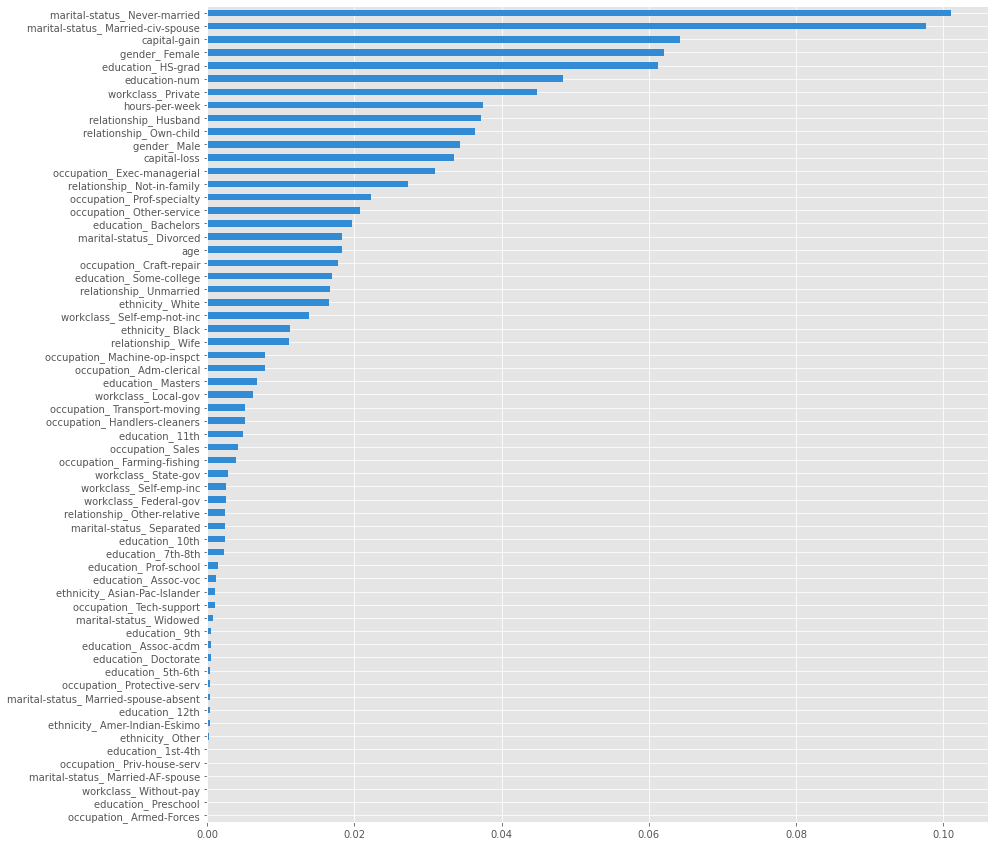

In [17]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [14, 15]
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_1)

 * Model 2 (Decision Tree)

15-Mar-21 23:58:38 - Generating a feature importance plot using SKATER for Model 2 ...
15-Mar-21 23:58:38 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-03-15 23:58:56,245 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 17 seconds

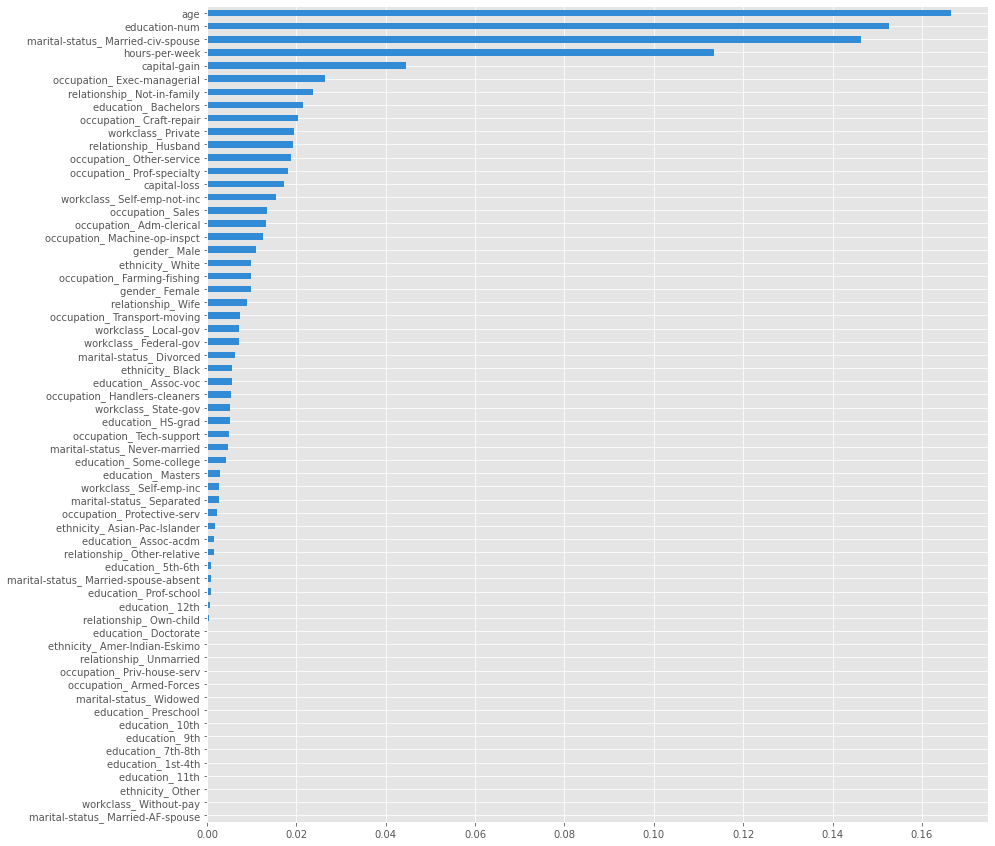

In [18]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_2)

 * Model 3 (Random Forest)

15-Mar-21 23:59:15 - Generating a feature importance plot using SKATER for Model 3 ...
15-Mar-21 23:59:15 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-03-15 23:59:32,254 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 32 seconds

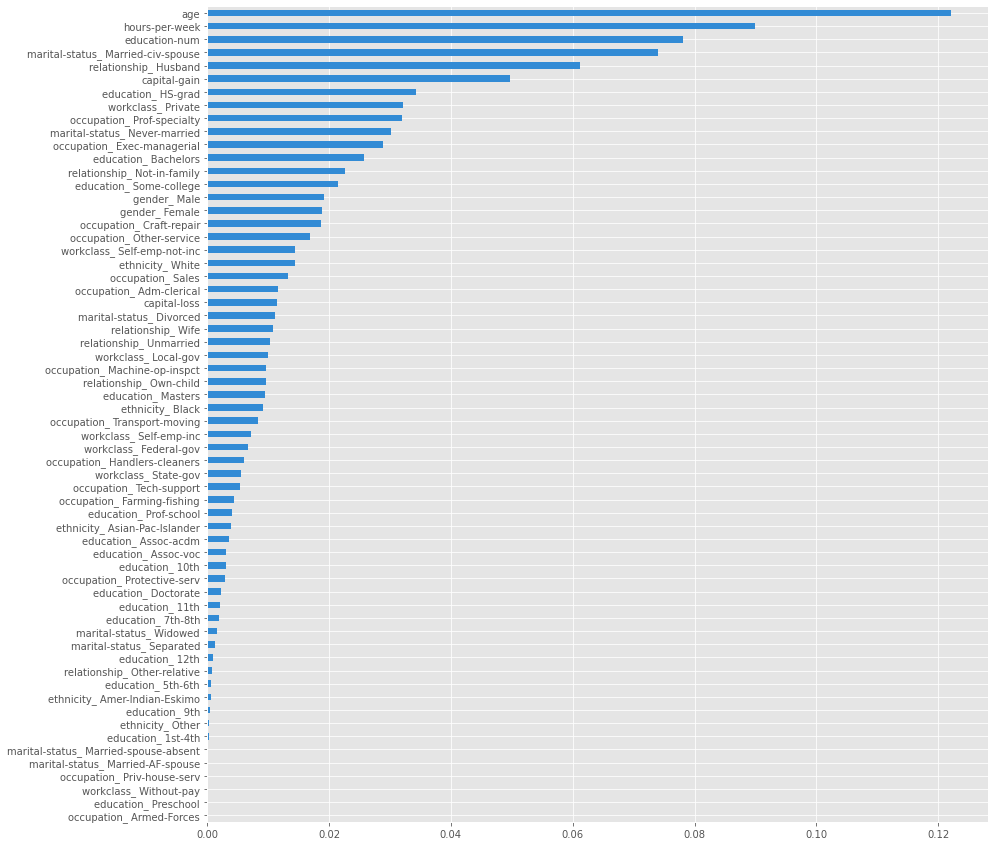

In [19]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_3)

 * Model 4 (Support Vector Machine)

16-Mar-21 00:00:07 - Generating a feature importance plot using SKATER for Model 4 ...
16-Mar-21 00:00:07 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-03-16 00:01:35,428 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 81 seconds

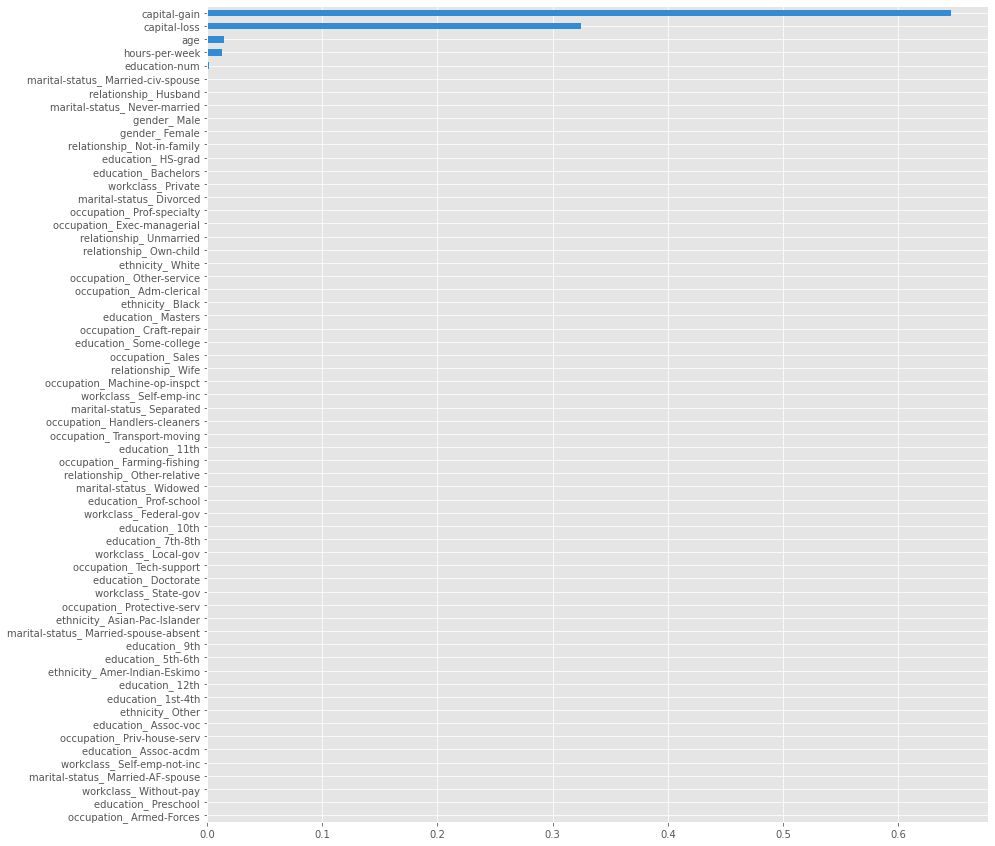

In [20]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_4)

In [21]:
print('\n' + generate_feature_importance_explanation(FeatureImportanceType.SKATER, models, 4))

16-Mar-21 00:02:58 - Generating feature importance explanation for SKATER ...
2021-03-16 00:04:20,540 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 37 seconds

2021-03-16 00:06:21,818 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 36 seconds

2021-03-16 00:08:18,199 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 48 seconds

2021-03-16 00:10:46,019 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[62/62] features ████████████████████ Time elapsed: 350 seconds
Summary:
 The most important feature for Model 1 is marital-status_ Never-married with weight ~0.108.
 The 2nd most influential feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.098.
 The 3rd most important feature for Model 1 is capital-gain with weight ~0.063.
 The 4th most important feature for Model 1 is gender_ Female with weight ~0.061.
 
 The most influential feature for Model 2 is age with weight ~0.158.
 The 2nd best feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.144, alike 2nd for Model 1.
 The 3rd most valuable feature for Model 2 is education-num with weight ~0.135.
 The 4th most important feature for Model 2 is hours-per-week with weight ~0.116.
 
 The best feature for Model 3 is age with weight ~0.127, alike 1st for Model 2.
 The 2nd most important feature for Model 3 is hours-per-week with weight ~0.092, identical to 4th for Model 2.
 The 3rd best feature for 

#### Shap

In the cell below we use the [SHAP](https://github.com/slundberg/shap) (SHapley Additive exPlanations). It uses a combination of feature contributions and game theory to come up with SHAP values. Then, it computes the global feature importance by taking the average of the SHAP value magnitudes across the dataset.

 * Model 1 (Logistic Regression)

16-Mar-21 00:16:36 - Generating a feature importance plot using SHAP for Model 1 ...
16-Mar-21 00:16:36 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

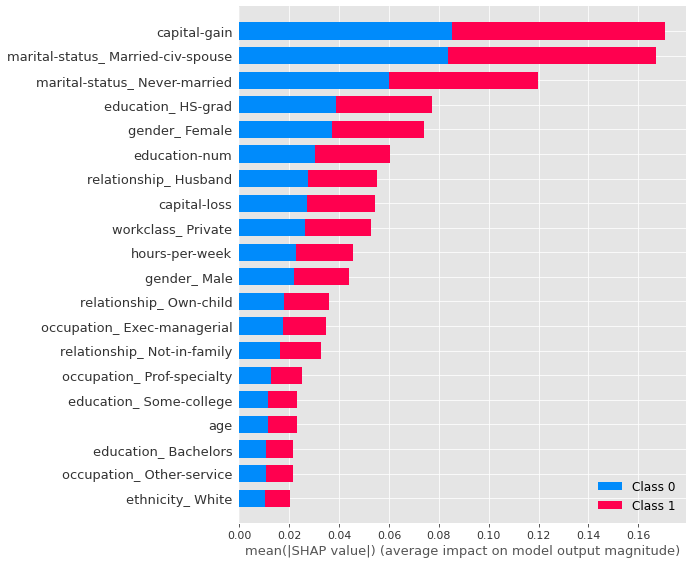

In [22]:
from shap import initjs
initjs()

%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

generate_feature_importance_plot(FeatureImportanceType.SHAP, model_1)

 * Model 2 (Decision Tree)

16-Mar-21 00:32:13 - Generating a feature importance plot using SHAP for Model 2 ...
16-Mar-21 00:32:13 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

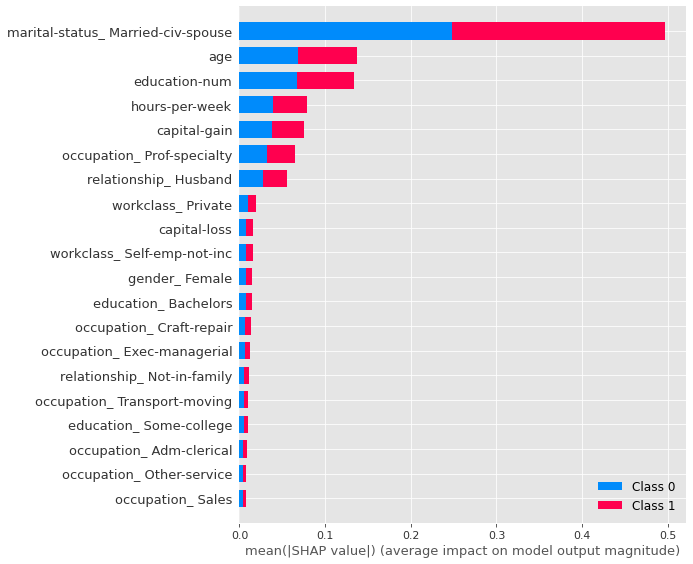

In [23]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_2)

 * Model 3 (Random Forest)

16-Mar-21 00:47:42 - Generating a feature importance plot using SHAP for Model 3 ...
16-Mar-21 00:47:42 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

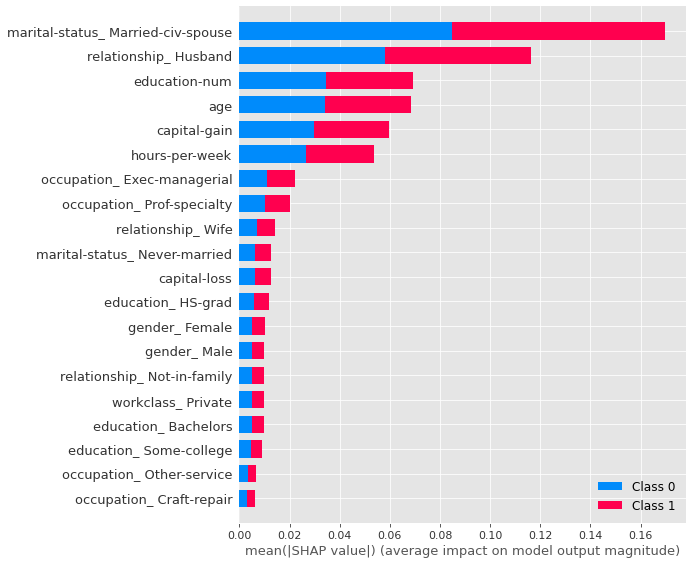

In [24]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_3)

 * Model 4 (Support Vector Machine)

16-Mar-21 01:19:21 - Generating a feature importance plot using SHAP for Model 4 ...
16-Mar-21 01:19:21 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

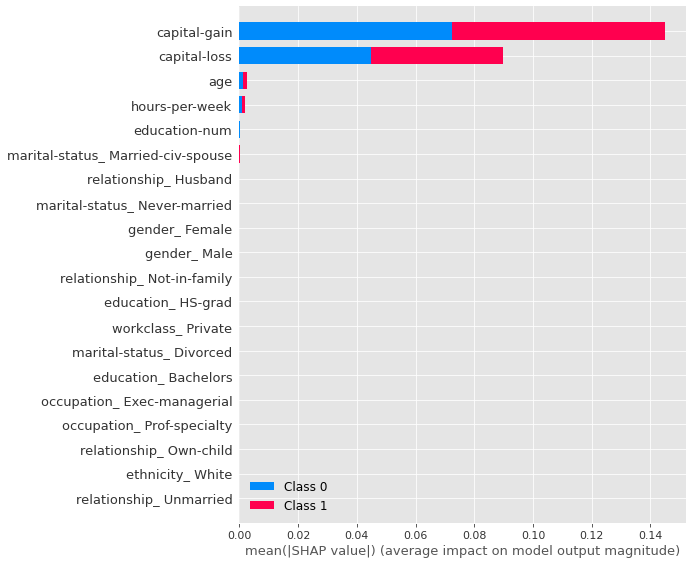

In [25]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_4)

In [26]:
print(generate_feature_importance_explanation(FeatureImportanceType.SHAP, models, 4))

16-Mar-21 13:29:39 - Generating feature importance explanation for SHAP ...


Summary:
 The highest feature for Model 1 is capital-gain with weight ~0.171.
 The 2nd most important feature for Model 1 is marital-status_ Married-civ-spouse with weight ~0.167.
 The 3rd most influential feature for Model 1 is marital-status_ Never-married with weight ~0.12.
 The 4th best feature for Model 1 is education_ HS-grad with weight ~0.077.
 
 The most important feature for Model 2 is marital-status_ Married-civ-spouse with weight ~0.496, matching 2nd for Model 1.
 The 2nd most influential feature for Model 2 is age with weight ~0.137.
 The 3rd most important feature for Model 2 is education-num with weight ~0.134.
 The 4th best feature for Model 2 is hours-per-week with weight ~0.078.
 
 The most important feature for Model 3 is marital-status_ Married-civ-spouse with weight ~0.17, matching 2nd for Model 1.
 The 2nd most influential feature for Model 3 is relationship_ Husband with weight ~0.116.
 The 3rd most important feature for Model 3 is education-num with weight ~0.06

### Partial Dependence Plots
The partial dependence plot (short PDP or PD plot) shows the marginal effect one or two features have on the predicted outcome of a machine learning model. A partial dependence plot can show whether the relationship between the target and a feature is linear, monotonic or more complex. For example, when applied to a linear regression model, partial dependence plots always show a linear relationship.

#### PDPBox

[PDPBox](https://github.com/SauceCat/PDPbox) is the first module that we use for ploting partial dependence. We will generate two plots, one for only one feature - **age** and one for two features - **age** and **education-num**.
 * Model 1 (Logistic Regression)

16-Mar-21 13:29:39 - Generating a PDP plot using PDPBox for Model 1 ...
16-Mar-21 13:29:52 - Generating a PDP plot using PDPBox for Model 1 ...


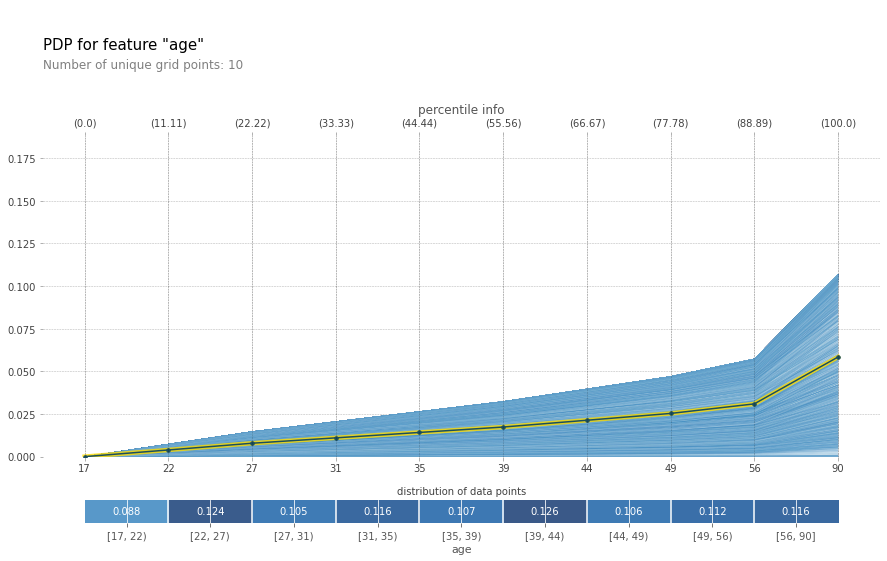

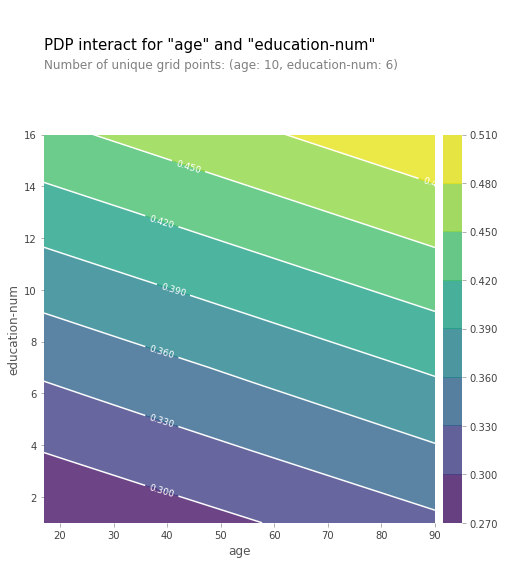

In [27]:
generate_pdp_plots(PDPType.PDPBox, model_1, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

16-Mar-21 13:30:03 - Generating a PDP plot using PDPBox for Model 2 ...
16-Mar-21 13:30:16 - Generating a PDP plot using PDPBox for Model 2 ...


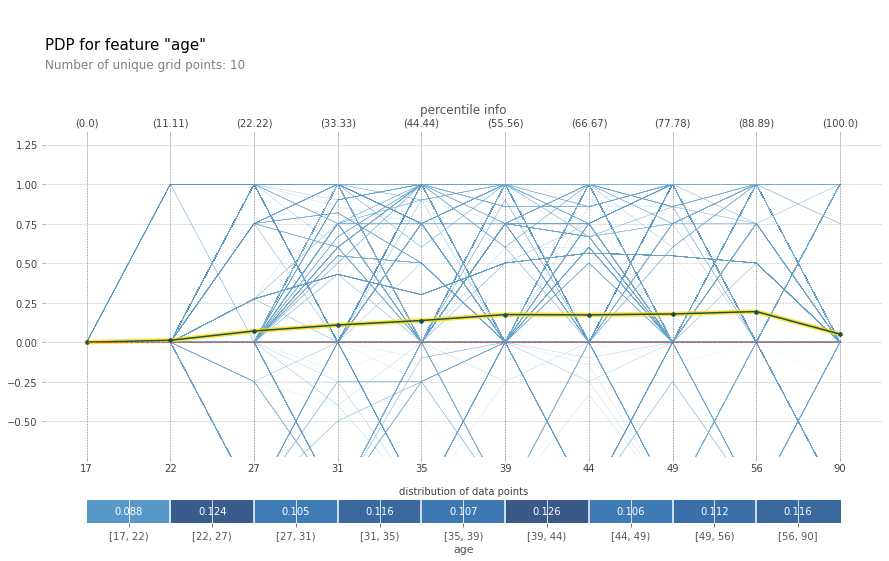

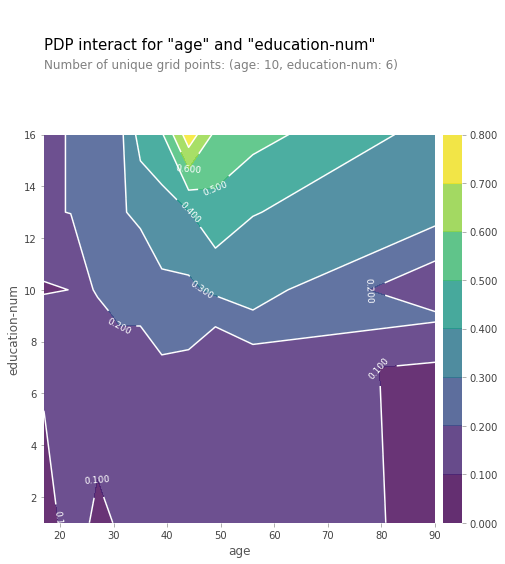

In [28]:
generate_pdp_plots(PDPType.PDPBox, model_2, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_2, "age", "education-num")

 * Model 3 (Random Forest)

16-Mar-21 13:30:26 - Generating a PDP plot using PDPBox for Model 3 ...
16-Mar-21 13:30:41 - Generating a PDP plot using PDPBox for Model 3 ...


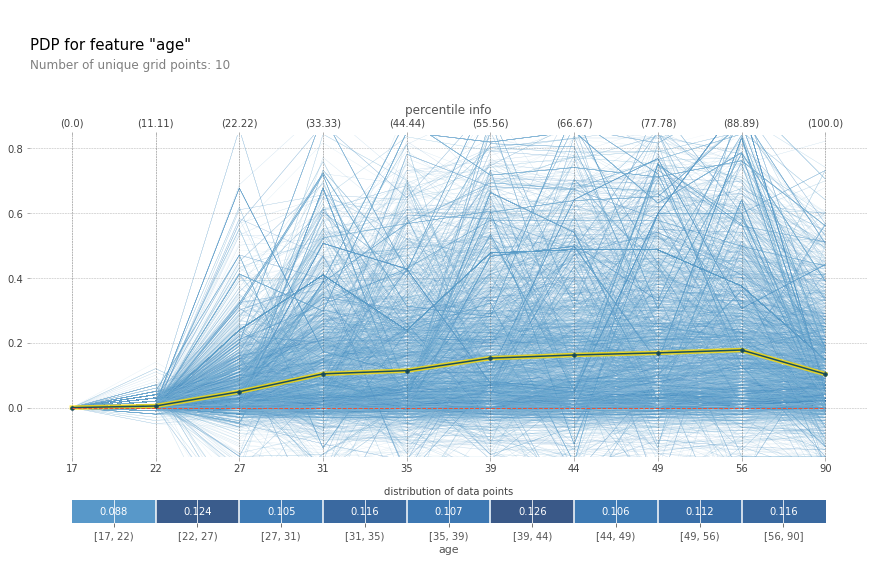

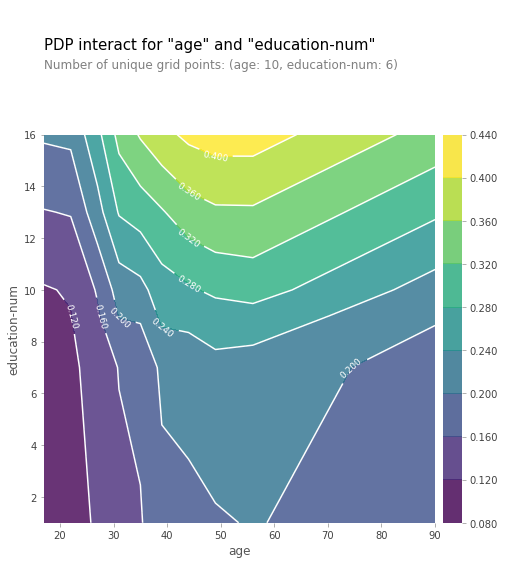

In [29]:
generate_pdp_plots(PDPType.PDPBox, model_3, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

16-Mar-21 13:31:02 - Generating a PDP plot using PDPBox for Model 4 ...
16-Mar-21 13:36:56 - Generating a PDP plot using PDPBox for Model 4 ...


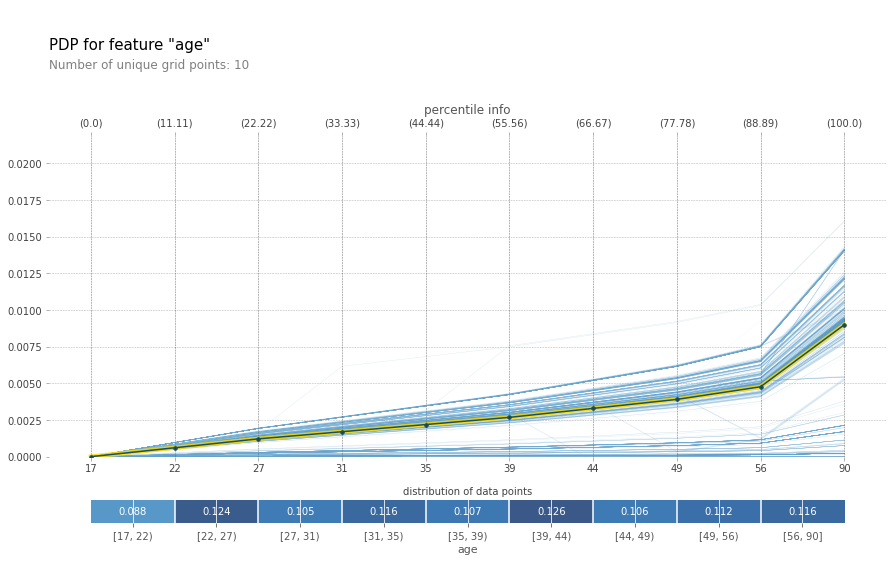

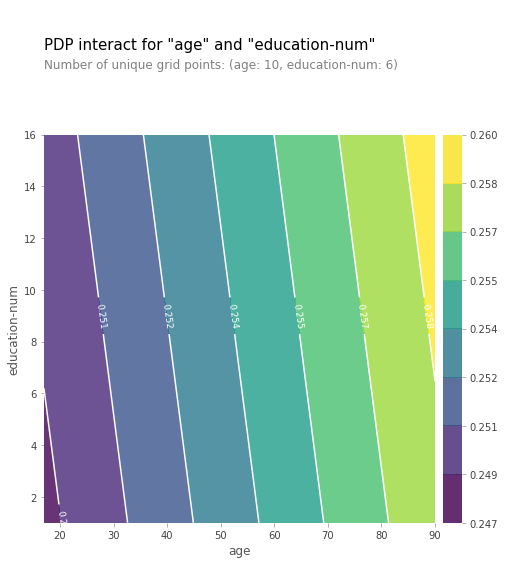

In [30]:
generate_pdp_plots(PDPType.PDPBox, model_4, "age", "None")
generate_pdp_plots(PDPType.PDPBox, model_4, "age", "education-num")

In the two examples below we will use *Skater* and *SHAP* for generating PDPs using features: **age** and **education-num**.
#### Skater
 * Model 1 (Logistic Regression)

16-Mar-21 14:20:47 - Generating a PDP plot using SKATER for Model 1 ...
2021-03-16 14:20:55,112 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 331 seconds

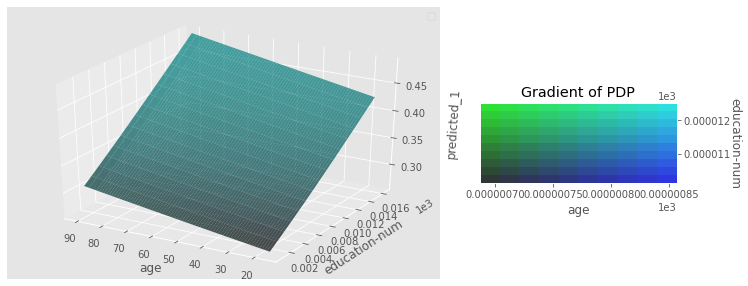

In [31]:
generate_pdp_plots(PDPType.SKATER, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

16-Mar-21 14:26:28 - Generating a PDP plot using SKATER for Model 2 ...
2021-03-16 14:26:36,627 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 285 seconds

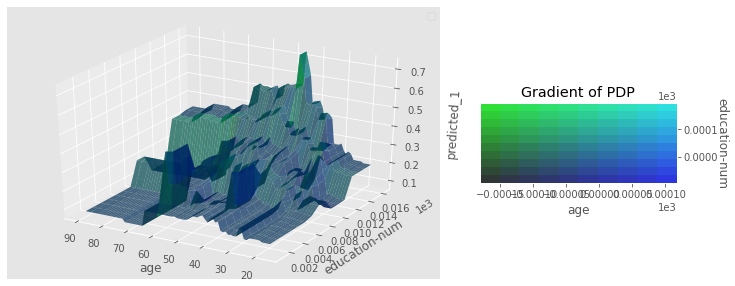

In [32]:
generate_pdp_plots(PDPType.SKATER, model_2, "age", "education-num")

 * Model 3 (Random Forest)

16-Mar-21 14:31:24 - Generating a PDP plot using SKATER for Model 3 ...
2021-03-16 14:31:32,328 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 468 seconds

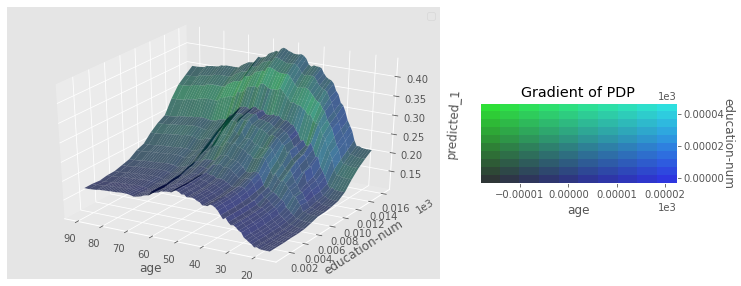

In [33]:
generate_pdp_plots(PDPType.SKATER, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

16-Mar-21 14:39:22 - Generating a PDP plot using SKATER for Model 4 ...
2021-03-16 14:39:30,551 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 1521 seconds

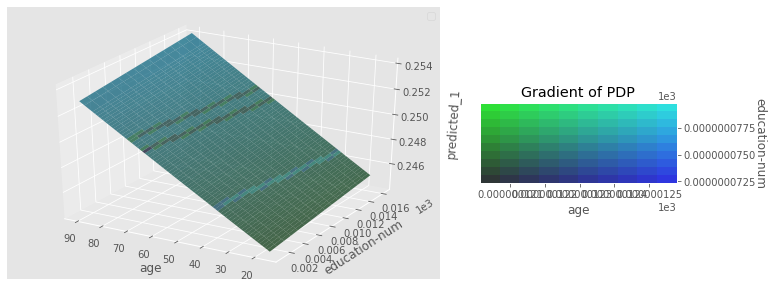

In [34]:
generate_pdp_plots(PDPType.SKATER, model_4, "age", "education-num")

#### SHAP
 * Model 1 (Logistic Regression)

16-Mar-21 15:04:53 - Generating a PDP plot using SHAP for Model 1 ...


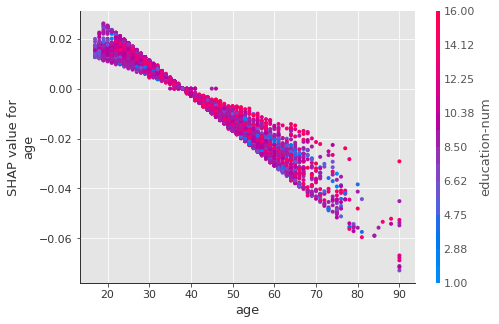

In [35]:
generate_pdp_plots(PDPType.SHAP, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

16-Mar-21 15:04:54 - Generating a PDP plot using SHAP for Model 2 ...


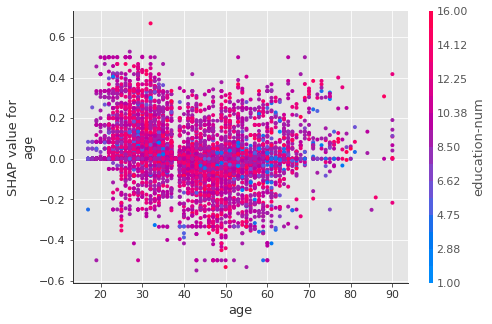

In [36]:
generate_pdp_plots(PDPType.SHAP, model_2, "age", "education-num")

 * Model 3 (Random Forest)

16-Mar-21 15:04:54 - Generating a PDP plot using SHAP for Model 3 ...


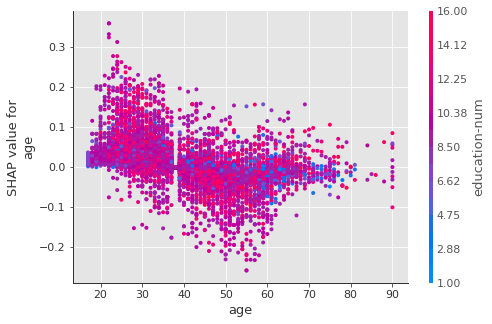

In [37]:
generate_pdp_plots(PDPType.SHAP, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

16-Mar-21 15:04:55 - Generating a PDP plot using SHAP for Model 4 ...


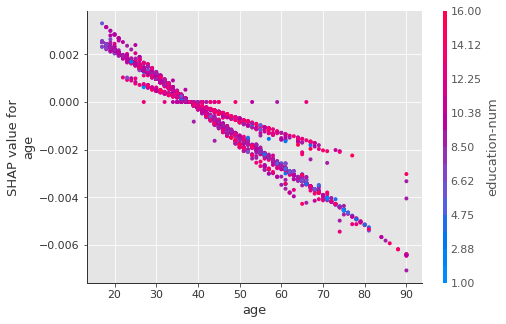

In [38]:
generate_pdp_plots(PDPType.SHAP, model_4, "age", "education-num")

## Local model interpretations
Local interpretation focuses on specifics of each individual and provides explanations that can lead to a better understanding of the feature contribution in smaller groups of individuals that are often overlooked by the global interpretation techniques. We will use two moduels for interpreting single instances - SHAP and LIME.

#### SHAP
SHAP leverages the idea of Shapley values for model feature influence scoring. The technical definition of a Shapley value is the “average marginal contribution of a feature value over all possible coalitions.” In other words, Shapley values consider all possible predictions for an instance using all possible combinations of inputs. Because of this exhaustive approach, SHAP can guarantee properties like consistency and local accuracy. LIME, on the other hand, does not offer such guarantees.

#### LIME
[LIME](https://github.com/marcotcr/lime) (Local Interpretable Model-agnostic Explanations) builds sparse linear models around each prediction to explain how the black box model works in that local vicinity. While treating the model as a black box, we perturb the instance we want to explain and learn a sparse linear model around it, as an explanation. LIME has the advantage over *SHAP*, that it is a lot faster.



In [39]:
examples = []
example_types = [ExampleType.FALSELY_CLASSIFIED]
for example_type in example_types:
    for model in models:
        example = get_test_examples(model, example_type, 1)[0]
        while example in examples:
            example = get_test_examples(model, example_type, 1)[0]
        examples.append(example)
display(examples)

[2104, 1638, 990, 8174]

##### Example 1

In [40]:
example = examples[0]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 2104's data: 
age                                47
workclass                   Local-gov
education                     HS-grad
education-num                       9
marital-status     Married-civ-spouse
occupation              Other-service
relationship                     Wife
ethnicity                       White
gender                         Female
capital-gain                        0
capital-loss                        0
hours-per-week                      7
Name: 16435, dtype: object
Actual result for example 2104:  >50K

Example 2104 was truly classified by no model and falsely classified by Model 1, Model 2, Model 3, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [41]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

16-Mar-21 15:05:31 - Generating a single instance explanation using LIME for Model 1 ...
16-Mar-21 15:05:31 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
16-Mar-21 15:05:36 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.73. LIME's explanation: 
The feature that mostly changes Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.284.
The feature that largely influences Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5859.
The feature with the second largest influence on Model 1's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.2055.




16-Mar-21 15:05:40 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.73. SHAP's explanation: 
The feature that mainly impacts Model 1's positive (1) prediction probability is occupation_ Other-service with value of 0.1436.
The feature with the second largest impact on Model 1's positive (1) prediction probability is gender_ Female with value of 0.1405.
The third most important feature for the positive (1) prediction probability of Model 1 is education_ HS-grad with value of 0.1353
The feature that mostly affects Model 1's negative (0) prediction probability is marital-status_ Married-civ-spouse with value of -0.1741.
The feature with the second largest change on Model 1's negative (0) prediction probability is relationship_ Wife with value of -0.1211.




 * Model 2 (Decision Tree)

In [42]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

16-Mar-21 15:05:40 - Generating a single instance explanation using LIME for Model 2 ...
16-Mar-21 15:05:40 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
16-Mar-21 15:05:45 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that mostly impacts Model 2's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.2317.
The feature with the second most substantial impact on Model 2's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.057.
The feature that largely affects Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5071.
The feature with the second largest influence on Model 2's negative (0) prediction probability is education-num <= 9.00 with value of -0.0844.




16-Mar-21 15:05:50 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that mostly impacts Model 2's positive (1) prediction probability is education-num with value of 0.2503.
The feature with the second largest impact on Model 2's positive (1) prediction probability is hours-per-week with value of 0.153.
The third most effective feature for the positive (1) prediction probability of Model 2 is occupation_ Other-service with value of 0.0311
The feature that mainly impacts Model 2's negative (0) prediction probability is marital-status_ Married-civ-spouse with value of -0.3862.
The feature with the second largest influence on Model 2's negative (0) prediction probability is age with value of -0.0682.




 * Model 3 (Random Forest)

In [43]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

16-Mar-21 15:05:50 - Generating a single instance explanation using LIME for Model 3 ...
16-Mar-21 15:05:50 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
16-Mar-21 15:05:54 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.93. LIME's explanation: 
The feature that largely impacts Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1286.
The feature that primarily changes Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4552.
The feature with the second largest affect on Model 3's negative (0) prediction probability is occupation= Other-service with value of -0.0756.




16-Mar-21 15:05:59 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.93. SHAP's explanation: 
The feature that primarily impacts Model 3's positive (1) prediction probability is occupation_ Other-service with value of 0.0962.
The feature with the second biggest change on Model 3's positive (1) prediction probability is hours-per-week with value of 0.0526.
The third most impactful feature for the positive (1) prediction probability of Model 3 is education_ HS-grad with value of 0.0339
The feature that largely affects Model 3's negative (0) prediction probability is marital-status_ Married-civ-spouse with value of -0.1261.
The feature with the second biggest affect on Model 3's negative (0) prediction probability is relationship_ Wife with value of -0.0972.




 * Model 4 (Support Vector Machine)

In [44]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

16-Mar-21 15:06:00 - Generating a single instance explanation using LIME for Model 4 ...
16-Mar-21 15:06:00 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
16-Mar-21 15:06:23 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. LIME's explanation: 
The feature that primarily changes Model 4's positive (1) prediction probability is education= HS-grad with value of 0.0024.
The feature that mainly affects Model 4's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.4383.
The feature with the second most considerable impact on Model 4's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4205.




16-Mar-21 15:07:21 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. SHAP's explanation: 
The feature that mainly impacts Model 4's positive (1) prediction probability is capital-loss with value of 0.0256.
The feature with the second biggest affect on Model 4's positive (1) prediction probability is hours-per-week with value of 0.0044.
The third most important feature for the positive (1) prediction probability of Model 4 is education-num with value of 0.0001
The feature that mainly changes Model 4's negative (0) prediction probability is capital-gain with value of -0.0357.
The feature with the second largest change on Model 4's negative (0) prediction probability is age with value of -0.0011.




##### Example 2

In [45]:
example = examples[1]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 1638's data: 
age                           39
workclass                Private
education                Masters
education-num                 14
marital-status     Never-married
occupation                 Sales
relationship       Not-in-family
ethnicity                  White
gender                      Male
capital-gain                   0
capital-loss                2444
hours-per-week                45
Name: 16411, dtype: object
Actual result for example 1638:  >50K

Example 1638 was truly classified by Model 1, Model 3, Model 4 and falsely classified by Model 2.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [46]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

16-Mar-21 15:08:31 - Generating a single instance explanation using LIME for Model 1 ...
16-Mar-21 15:08:35 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.57. LIME's explanation: 
The feature that mostly impacts Model 1's positive (1) prediction probability is capital-loss > 0.00 with value of 0.2011.
The feature with the second most considerable impact on Model 1's positive (1) prediction probability is education-num > 13.00 with value of 0.0812.
The feature that primarily changes Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5557.
The feature with the second most considerable change on Model 1's negative (0) prediction probability is marital-status= Never-married with value of -0.2632.




16-Mar-21 15:08:40 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.57. SHAP's explanation: 
The feature that mostly changes Model 1's positive (1) prediction probability is capital-loss with value of 0.3161.
The feature with the second most considerable change on Model 1's positive (1) prediction probability is education_ Masters with value of 0.0792.
The third most influential feature for the positive (1) prediction probability of Model 1 is education-num with value of 0.0753
The feature that primarily impacts Model 1's negative (0) prediction probability is marital-status_ Never-married with value of -0.2555.
The feature with the second most substantial affect on Model 1's negative (0) prediction probability is capital-gain with value of -0.0788.




 * Model 2 (Decision Tree)

In [47]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

16-Mar-21 15:08:40 - Generating a single instance explanation using LIME for Model 2 ...
16-Mar-21 15:08:44 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that mainly influences Model 2's positive (1) prediction probability is education-num > 13.00 with value of 0.1554.
The feature with the second most substantial impact on Model 2's positive (1) prediction probability is relationship= Not-in-family with value of 0.055.
The third most impactful feature for the positive (1) prediction probability of Model 2 is 37.00 < age <= 47.00 with value of 0.0519
The feature that mainly affects Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4853.
The feature with the second biggest impact on Model 2's negative (0) prediction probability is marital-status= Never-married with value of -0.1576.




16-Mar-21 15:08:49 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that largely influences Model 2's positive (1) prediction probability is education-num with value of 0.4595.
The feature with the second biggest impact on Model 2's positive (1) prediction probability is occupation_ Sales with value of 0.1762.
The third most impactful feature for the positive (1) prediction probability of Model 2 is age with value of 0.0095
The feature that largely changes Model 2's negative (0) prediction probability is capital-loss with value of -0.5.
The feature with the second biggest change on Model 2's negative (0) prediction probability is relationship_ Not-in-family with value of -0.0405.




 * Model 3 (Random Forest)

In [48]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

16-Mar-21 15:08:49 - Generating a single instance explanation using LIME for Model 3 ...
16-Mar-21 15:08:54 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.62. LIME's explanation: 
The feature that mostly impacts Model 3's positive (1) prediction probability is education-num > 13.00 with value of 0.0969.
The feature with the second most substantial change on Model 3's positive (1) prediction probability is capital-loss > 0.00 with value of 0.0703.
The third most effective feature for the positive (1) prediction probability of Model 3 is 37.00 < age <= 47.00 with value of 0.0413
The feature that largely affects Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4252.
The feature with the second biggest affect on Model 3's negative (0) prediction probability is marital-status= Never-married with value of -0.1001.




16-Mar-21 15:08:58 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.62. SHAP's explanation: 
The feature that mostly affects Model 3's positive (1) prediction probability is capital-loss with value of 0.2128.
The feature with the second most considerable influence on Model 3's positive (1) prediction probability is education-num with value of 0.1427.
The third most effective feature for the positive (1) prediction probability of Model 3 is hours-per-week with value of 0.1017
The feature that mainly changes Model 3's negative (0) prediction probability is age with value of -0.0029.




 * Model 4 (Support Vector Machine)

In [49]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

16-Mar-21 15:08:59 - Generating a single instance explanation using LIME for Model 4 ...
16-Mar-21 15:09:22 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.79. LIME's explanation: 
The feature that mostly influences Model 4's positive (1) prediction probability is capital-loss > 0.00 with value of 0.4222.
The feature with the second most considerable impact on Model 4's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0058.
The feature that largely affects Model 4's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.3871.
The feature with the second biggest impact on Model 4's negative (0) prediction probability is workclass= Private with value of -0.0026.




16-Mar-21 15:10:21 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.79. SHAP's explanation: 
The feature that primarily changes Model 4's positive (1) prediction probability is capital-loss with value of 0.5628.
The feature with the second biggest impact on Model 4's positive (1) prediction probability is capital-gain with value of 0.0432.
The third most important feature for the positive (1) prediction probability of Model 4 is hours-per-week with value of 0.0005
The feature that largely influences Model 4's negative (0) prediction probability is marital-status_ Never-married with value of -0.0.
The feature with the second biggest impact on Model 4's negative (0) prediction probability is relationship_ Not-in-family with value of -0.0.




##### Example 3

In [50]:
example = examples[2]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 990's data: 
age                                49
workclass                     Private
education                     HS-grad
education-num                       9
marital-status     Married-civ-spouse
occupation               Craft-repair
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                        0
hours-per-week                     40
Name: 10790, dtype: object
Actual result for example 990:  >50K

Example 990 was truly classified by Model 2 and falsely classified by Model 1, Model 3, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [51]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

16-Mar-21 15:11:31 - Generating a single instance explanation using LIME for Model 1 ...
16-Mar-21 15:11:35 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.59. LIME's explanation: 
The feature that mainly affects Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.279.
The feature with the second most considerable change on Model 1's positive (1) prediction probability is relationship= Husband with value of 0.1105.
The feature that largely changes Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5826.
The feature with the second biggest impact on Model 1's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.1935.




16-Mar-21 15:11:40 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.59. SHAP's explanation: 
The feature that primarily affects Model 1's positive (1) prediction probability is education_ HS-grad with value of 0.149.
The feature with the second biggest affect on Model 1's positive (1) prediction probability is capital-gain with value of 0.0853.
The third most important feature for the positive (1) prediction probability of Model 1 is occupation_ Craft-repair with value of 0.0658
The feature that mainly affects Model 1's negative (0) prediction probability is marital-status_ Married-civ-spouse with value of -0.1969.
The feature with the second most considerable change on Model 1's negative (0) prediction probability is relationship_ Husband with value of -0.0744.




 * Model 2 (Decision Tree)

In [52]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

16-Mar-21 15:11:40 - Generating a single instance explanation using LIME for Model 2 ...
16-Mar-21 15:11:44 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 0.55. LIME's explanation: 
The feature that primarily influences Model 2's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.2111.
The feature with the second biggest affect on Model 2's positive (1) prediction probability is age > 47.00 with value of 0.0363.
The feature that mostly affects Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5386.
The feature with the second most substantial change on Model 2's negative (0) prediction probability is education-num <= 9.00 with value of -0.1091.




16-Mar-21 15:11:49 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 0.55. SHAP's explanation: 
The feature that mostly influences Model 2's positive (1) prediction probability is marital-status_ Married-civ-spouse with value of 0.6577.
The feature with the second most substantial influence on Model 2's positive (1) prediction probability is occupation_ Craft-repair with value of 0.0744.
The feature that largely impacts Model 2's negative (0) prediction probability is education-num with value of -0.1341.
The feature with the second biggest change on Model 2's negative (0) prediction probability is age with value of -0.0512.




 * Model 3 (Random Forest)

In [53]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

16-Mar-21 15:11:49 - Generating a single instance explanation using LIME for Model 3 ...
16-Mar-21 15:11:54 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.51. LIME's explanation: 
The feature that mainly influences Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1241.
The feature with the second biggest influence on Model 3's positive (1) prediction probability is relationship= Husband with value of 0.0576.
The feature that largely influences Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4462.
The feature with the second most considerable influence on Model 3's negative (0) prediction probability is hours-per-week <= 40.00 with value of -0.0786.




16-Mar-21 15:11:59 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.51. SHAP's explanation: 
The feature that mainly influences Model 3's positive (1) prediction probability is education-num with value of 0.0203.
The feature with the second most substantial change on Model 3's positive (1) prediction probability is occupation_ Craft-repair with value of 0.0068.
The third most effective feature for the positive (1) prediction probability of Model 3 is education_ HS-grad with value of 0.0016
The feature that primarily affects Model 3's negative (0) prediction probability is relationship_ Husband with value of -0.2043.
The feature with the second biggest influence on Model 3's negative (0) prediction probability is marital-status_ Married-civ-spouse with value of -0.1912.




 * Model 4 (Support Vector Machine)

In [54]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

16-Mar-21 15:11:59 - Generating a single instance explanation using LIME for Model 4 ...
16-Mar-21 15:12:22 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. LIME's explanation: 
The feature that mainly changes Model 4's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.4144.
The feature with the second most substantial change on Model 4's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4141.




16-Mar-21 15:13:20 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. SHAP's explanation: 
The feature that mostly influences Model 4's positive (1) prediction probability is capital-loss with value of 0.0258.
The feature with the second most considerable influence on Model 4's positive (1) prediction probability is hours-per-week with value of 0.0001.
The third most influential feature for the positive (1) prediction probability of Model 4 is education-num with value of 0.0001
The feature that mainly influences Model 4's negative (0) prediction probability is capital-gain with value of -0.0361.
The feature with the second largest change on Model 4's negative (0) prediction probability is age with value of -0.0013.




##### Example 4

In [55]:
example = examples[3]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 8174's data: 
age                            43
workclass                 Private
education               Bachelors
education-num                  13
marital-status      Never-married
occupation         Prof-specialty
relationship        Not-in-family
ethnicity                   White
gender                       Male
capital-gain                    0
capital-loss                    0
hours-per-week                 45
Name: 19838, dtype: object
Actual result for example 8174:  >50K

Example 8174 was truly classified by no model and falsely classified by Model 1, Model 2, Model 3, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [56]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

16-Mar-21 15:14:29 - Generating a single instance explanation using LIME for Model 1 ...
16-Mar-21 15:14:34 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.72. LIME's explanation: 
The feature that primarily changes Model 1's positive (1) prediction probability is education= Bachelors with value of 0.1169.
The feature with the second most considerable influence on Model 1's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0901.
The feature that largely changes Model 1's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5765.
The feature with the second biggest impact on Model 1's negative (0) prediction probability is marital-status= Never-married with value of -0.2596.




16-Mar-21 15:14:38 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.72. SHAP's explanation: 
The feature that primarily affects Model 1's positive (1) prediction probability is marital-status_ Never-married with value of 0.2692.
The feature with the second biggest impact on Model 1's positive (1) prediction probability is capital-gain with value of 0.0794.
The third most important feature for the positive (1) prediction probability of Model 1 is relationship_ Not-in-family with value of 0.0754
The feature that mostly impacts Model 1's negative (0) prediction probability is occupation_ Prof-specialty with value of -0.1066.
The feature with the second most substantial impact on Model 1's negative (0) prediction probability is education_ Bachelors with value of -0.0716.




 * Model 2 (Decision Tree)

In [57]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

16-Mar-21 15:14:39 - Generating a single instance explanation using LIME for Model 2 ...
16-Mar-21 15:14:43 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that mainly influences Model 2's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0737.
The feature with the second most considerable influence on Model 2's positive (1) prediction probability is 10.00 < education-num <= 13.00 with value of 0.0645.
The third most influential feature for the positive (1) prediction probability of Model 2 is occupation= Prof-specialty with value of 0.0627
The feature that primarily impacts Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5302.
The feature with the second biggest change on Model 2's negative (0) prediction probability is marital-status= Never-married with value of -0.164.




16-Mar-21 15:14:47 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that primarily impacts Model 2's positive (1) prediction probability is hours-per-week with value of 0.2774.
The feature with the second most substantial change on Model 2's positive (1) prediction probability is education_ Bachelors with value of 0.1441.
The third most important feature for the positive (1) prediction probability of Model 2 is education-num with value of 0.119
The feature that largely impacts Model 2's negative (0) prediction probability is occupation_ Prof-specialty with value of -0.3333.
The feature with the second most considerable affect on Model 2's negative (0) prediction probability is relationship_ Not-in-family with value of -0.131.




 * Model 3 (Random Forest)

In [58]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

16-Mar-21 15:14:48 - Generating a single instance explanation using LIME for Model 3 ...
16-Mar-21 15:14:52 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.7. LIME's explanation: 
The feature that mostly influences Model 3's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0641.
The feature with the second biggest influence on Model 3's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0456.
The third most important feature for the positive (1) prediction probability of Model 3 is 10.00 < education-num <= 13.00 with value of 0.0447
The feature that mainly impacts Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4366.
The feature with the second largest affect on Model 3's negative (0) prediction probability is marital-status= Never-married with value of -0.1006.




16-Mar-21 15:14:57 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.7. SHAP's explanation: 
The feature that mostly affects Model 3's positive (1) prediction probability is hours-per-week with value of 0.057.
The feature with the second biggest impact on Model 3's positive (1) prediction probability is marital-status_ Never-married with value of 0.0149.
The feature that primarily affects Model 3's negative (0) prediction probability is occupation_ Prof-specialty with value of -0.1235.
The feature with the second biggest change on Model 3's negative (0) prediction probability is relationship_ Not-in-family with value of -0.0889.




 * Model 4 (Support Vector Machine)

In [59]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

16-Mar-21 15:14:57 - Generating a single instance explanation using LIME for Model 4 ...
16-Mar-21 15:15:21 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. LIME's explanation: 
The feature that largely affects Model 4's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0033.
The feature that mostly impacts Model 4's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.4411.
The feature with the second most substantial affect on Model 4's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4307.




16-Mar-21 15:16:19 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.81. SHAP's explanation: 
The feature that primarily influences Model 4's positive (1) prediction probability is capital-loss with value of 0.0258.
The feature with the second most considerable affect on Model 4's positive (1) prediction probability is marital-status_ Never-married with value of 0.0.
The third most impactful feature for the positive (1) prediction probability of Model 4 is relationship_ Not-in-family with value of 0.0
The feature that mostly affects Model 4's negative (0) prediction probability is capital-gain with value of -0.0361.
The feature with the second biggest impact on Model 4's negative (0) prediction probability is age with value of -0.0006.


